In [2]:
import numpy as np
import scipy as sp
import pickle
import utilities as u
import preprocessing as pp
import SimulatedSimMats as ssm
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import UnityTransforms as ut
import SimilarityMatrixAnalysis as sm
import os

%matplotlib inline

%load_ext autoreload
%autoreload 2

In [3]:
with open("D:\\Morph_Results\\rare_sf_regression.pkl",'rb') as f:
    rare_sfreg = pickle.load(f)
    
with open("D:\\Morph_Results\\freq_sf_regression.pkl",'rb') as f:
    freq_sfreg = pickle.load(f)

In [4]:
print(rare_sfreg.keys())

dict_keys(['4139265.3', '4139265.4', '4139265.5', '4222168.1', '4343703.1', '4343706'])


In [5]:
print(ut.inv_wallmorphx(.1)-ut.inv_wallmorphx(0))

2.742068784907296


In [6]:
def mean_prior_post(dict_sfreg,sigma_likelihood=.3,x=np.linspace(-.1,1.1,num=1000)[np.newaxis,:]):
    mice = [mouse for mouse in dict_sfreg.keys()]
    priors = np.zeros([len(mice),x.shape[1]])
    for i, (mouse,res) in enumerate(dict_sfreg.items()):
        _prior=None
        for _p in res['priors']:
            if _prior is None:
                _prior = _p
            else:
                _prior+=_p
        _prior = _prior/_prior.sum()
        priors[i,:]=_prior
        
    prior = _prior.mean(axis=0,keepdims=True)
    prior = prior/prior.sum()
    post = prior*u.gaussian(np.linspace(-.3,1.3,num=1000)[:,np.newaxis],sigma_likelihood,np.linspace(-.3,1.3,num=1000)[np.newaxis,:])
    post = post/post.sum(axis=1,keepdims=True)
    return priors, prior, post
rare_priors,rare_prior,rare_post = mean_prior_post(rare_sfreg)
freq_priors,freq_prior,freq_post = mean_prior_post(freq_sfreg)
xx = np.linspace(-.3,1.3,num=1000)[np.newaxis,:]
rare_spline = ssm.make_sampling_spline(xx.ravel(),rare_prior)
freq_spline = ssm.make_sampling_spline(xx.ravel(),freq_prior)


In [44]:
def single_cell_model(log_cumprior_spline,d):
    '''
    implement hebbian learning for a single cell with inputs that are RBFs for some stimulus
    inputs: log_cumprior_spline - numpy univariate spline for sampling from the cumulative prior
            d - dictionary of parameters
    returns: w - weights of learned model
            yy - activity of cell
    '''
    
    ### INITIALIZATIONS
    THETA = np.linspace(-.3,1.3,num=d['nInputs']) 
    if d['alpha'] is None:
        d['alpha']=1/d['nInputs']
        
        
    w = 0*np.random.rand(d['nInputs']) +.5# uniformly distributed random small weights
    
   
    samples = log_cumprior_spline(np.random.rand(d['nSamples'])) # sample from prior
    ### LEARNING
    for i,s in enumerate(samples.tolist()):
        # generate inputs from those samples
        x =u.gaussian(THETA,d['sigma'],s+d['stim noise']*np.random.randn(1)) 
#         x =np.random.poisson(u.gaussian(THETA,d['sigma'],s)) #+d['stim noise']*np.random.randn(1)) 
        y=np.maximum(d['alpha']*np.dot(w,x) + d['act noise']*np.random.randn(1),0) # rectified activation of cell
#         y = np.random.poisson(d['alpha']*np.dot(w,x))
        # update weights
        dw = d['eta']*x*y - d['tau'] #+ d['dW noise']*np.random.randn(w.shape[0])
        w+=dw 
        w=np.maximum(np.minimum(w,d['Wmax']),0) # rectify and clamp range of weights
        

    ### SAMPLE FROM LEARNED MODEL
    morph_theta = np.linspace(-.3,1.3,num=1000) # morph values to sample at
    yy = np.zeros(morph_theta.shape) # output 
    for i,s in enumerate(morph_theta.tolist()):
        # inputs
        x =u.gaussian(THETA,d['sigma'],s+d['stim noise']*np.random.randn(1)) 
        yy[i]=np.maximum(d['alpha']*np.dot(w,x) + d['act noise']*np.random.randn(1),0) # rectified activation of cell
    
    return w,yy,morph_theta,samples


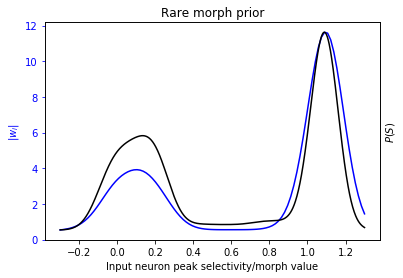

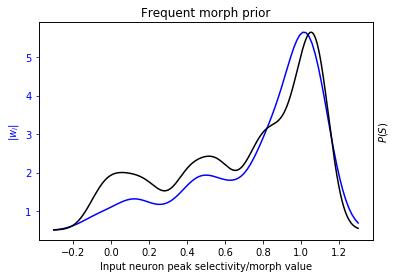

In [50]:
d_singlecell = {'stim noise': .0, # constant for sampling from standard Gaussian noise
    'nInputs': 100, # number of input neurons
    'nSamples':1000, # num training samples
    'alpha':.01, # constant to apply to output, defaults to 1/nInputs
    'eta': .1, # learning rate, results are somewhat sensitive to this value
    'sigma': .1, # width of radial basis functions
    'act noise':.0, # noise to apply to output
    'dW noise': 0.00, # constant to apply to weight update noise 
    'tau': .0000, # forgetting rate
    'Wmax':np.inf } # maximum value of weight

# rare morph prior
w,y,morph_theta,samples = single_cell_model(rare_spline,d_singlecell)

f,ax = plt.subplots()

ax.plot(np.linspace(-.3,1.3,num=w.shape[0]),w,color='blue')
ax.set_ylabel('$\|w_i\|$')
ax.yaxis.label.set_color('blue')
ax.tick_params(axis='y', colors='blue')
ax_dense = ax.twinx()
ax_dense.plot(np.linspace(-.3,1.3,num=rare_prior.shape[1]),rare_prior.ravel(),color='black',label='Prior Density')
ax_dense.set_ylabel('$P(S)$')
ax_dense.set_yticks([])
ax.set_xlabel('Input neuron peak selectivity/morph value')
ax.set_title("Rare morph prior")
f.savefig("D:\\Morph_Results\\figures\\KWTA\\single_cell_rare.pdf",format='pdf')



# frequent morph prior
w,y,morph_theta,samples = single_cell_model(freq_spline,d_singlecell)

f,ax = plt.subplots()
ax.plot(np.linspace(-.3,1.3,num=w.shape[0]),w,color='blue')
ax.set_ylabel('$\|w_i\|$')
ax.yaxis.label.set_color('blue')
ax.tick_params(axis='y', colors='blue')
ax_dense = ax.twinx()
ax_dense.plot(np.linspace(-.3,1.3,num=freq_prior.shape[1]),freq_prior.ravel(),color='black',label='Prior Density')
ax_dense.set_ylabel('$P(S)$')
ax_dense.set_yticks([])
ax.set_xlabel('Input neuron peak selectivity/morph value')
ax.set_title("Frequent morph prior")

f.savefig("D:\\Morph_Results\\figures\\KWTA\\single_cell_freq.pdf",format='pdf')


In [7]:
def kwta_network_model(log_cumprior_spline, d):
    
    ## INITIALIZATIONS
    THETA = np.linspace(-.1,1.1,num=d['nInputs']) 
    if d['alpha'] is None:
        d['alpha']=1/d['nInputs']
    W = .1*np.random.rand(d['nInputs'],d['n_neurons']) # weight matrix
    k = int(d['n_neurons']*d['wta_k']) # number of winners
    
    
    #draw samples for learning
    samples = log_cumprior_spline(np.random.rand(d['nSamples']))
    
    
    ## LEARNING
    for i,s in enumerate(samples.tolist()):
        # inputs
        x =u.gaussian(THETA,d['sigma'],s+d['stim noise']*np.random.randn(1)) 
#         x = np.random.gamma(u.gaussian(THETA,d['sigma'],s))
        # activation of each cell
        act = np.matmul(W.T,x)+ d['act noise']*np.random.randn(d['n_neurons'])
        sort = np.argsort(act) # sort to find K winners
        # determine output for K winners
        Y = np.zeros(act.shape)
        Y[sort[-1:-k-1:-1]]=d['alpha']*act[sort[-1:-k-1:-1]] 
        Y[sort[-k:0:-1]]=d['act noise']*act[sort[-k-1]]*np.random.randn(100-k)
        Y = np.maximum(Y,0) # make sure noise doesn't push the value negative
        
        # update weights
        dw = d['eta']*x[:,np.newaxis]*Y[np.newaxis,:] + d['dW noise']*np.random.randn(W.shape[0],W.shape[1])- d['tau']
        W+=dw
        W=np.maximum(np.minimum(W,d['Wmax']),0)
       

    
    ## SAMPLING
#     morph_theta = ut.wallmorphx(np.linspace(-.1,1.1,num=1000)) # to be closer to what is actually shown in trials
    morph_theta = ut.wallmorphx(np.linspace(-.3,1.3,num=1000)) # to be closer to what is actually shown in trials
    test_theta = morph_theta
    YY = np.zeros([test_theta.shape[0],d['n_neurons']])
    for i,s in enumerate(test_theta.tolist()):
        # inputs
        x =u.gaussian(THETA,d['sigma'],s+d['stim noise']*np.random.randn(1)) 
#         x = np.random.gamma(u.gaussian(THETA,d['sigma'],s))
        # activation of each cell
        act = np.matmul(W.T,x)+ d['act noise']*np.random.randn(d['n_neurons'])
        sort = np.argsort(act) # sort to find K winners
        # determine output for K winners
        YY[i,sort[-1:-k-1:-1]]=d['alpha']*act[sort[-1:-k-1:-1]]
        YY[i,sort[-k:0:-1]]=d['act noise']*act[sort[-k-1]]*np.random.randn(100-k)
        YY[i,:] = np.maximum(YY[i,:],0)


    ## SIMILARITY RATIO
    centroid0, centroid1 = YY[morph_theta<.05,:].mean(axis=0),YY[morph_theta>.9,:].mean(axis=0)
    centroid0/=np.linalg.norm(centroid0.ravel(),ord=2)
    centroid1/=np.linalg.norm(centroid1.ravel(),ord=2)
    YY=YY/np.linalg.norm(YY,ord=2,axis=1)[:,np.newaxis]
   
    sr = np.matmul(YY,centroid1[:,np.newaxis])/(np.matmul(YY,centroid0[:,np.newaxis])+np.matmul(YY,centroid1[:,np.newaxis]))
    
    return W,YY,sr



def plot_simmat(S_tm,em,vmax=None,morphcm='cool'):
    '''plot similarity matrices comparing each trial'''

    if vmax is None:
        vmax = np.percentile(S_tm.ravel(),90)
        vmin = np.percentile(S_tm.ravel(),10)


    f = plt.figure(figsize=[5,5])
    gs = gridspec.GridSpec(14,14)

    

    # sort by morph value
    cm_ax = f.add_subplot(gs[:10,:])
    cm_ax.imshow(S_tm,cmap='Greys',vmin=vmin,vmax=vmax,aspect='auto')
    cm_ax.set_yticks([])
    cm_ax.set_xticks([])
    cm_ax.set_ylabel("Trial")

    mm_ax = f.add_subplot(gs[10:12,:])
    mm_ax.scatter(np.arange(0,em.shape[0]),em,c=1-em,cmap=morphcm)
    mm_ax.set_xlim([0,em.shape[0]])
    mm_ax.set_xlabel("Trial")
    mm_ax.set_ylabel("$S$")
 

    return f, [cm_ax,mm_ax]

In [8]:

def loop_model_instances(sampling_spline,d,num=5,savepath=None):
    SS,LAR = [],[]
    THETA = np.linspace(-.3,1.3,num=d['nInputs']) 
    for i in range(num):

        if i%10==0:
            print(i)
        W,YY,lar= kwta_network_model(sampling_spline,d)

        # calculate similarity matrix
        YY_ = YY/np.linalg.norm(YY,2,axis=1)[:,np.newaxis]
        S = np.matmul(YY_,YY_.T)

        # save each models result
        SS.append(S)
        LAR.append(lar)

        if i <11:
            f,ax = plt.subplots()
            trsh=ax.plot(THETA,W)
            ax.set_title('Single neuron weights')
            ax.set_xlabel('input peak selectivity')
            if savepath is not None:
                f.savefig(os.path.join(savepath,"weights_lineplot_%i.png" %i ),format='png')


            f, axes = sm.plot_trial_simmat(np.minimum(S,1-1E-10),{'morphs':np.linspace(0,1,num=1000),'wallJitter':0,'rmask':np.ones([1000,]),'rewards':np.ones([1000,])}) #,vmax=None,morphcm='cool')
#             s_ax.set_title('Population Similarity Matrix')
            if savepath is not None:
                f.savefig(os.path.join(savepath,"simmat_%i.pdf" %i ),format='pdf')



            f,ax = plt.subplots()
            ax.scatter(ut.inv_wallmorphx(ut.wallmorphx(np.linspace(-.1,1.1,num=1000))),lar)
            ax.set_title('Similarity Fraction')
            ax.set_xlabel('Morph')
            ax.set_ylabel('SF')
            ax.set_ylim([np.amax(lar)+.05,np.amin(lar)-.05])
            if savepath is not None:
                f.savefig(os.path.join(savepath,"SF_%i.pdf" %i ),format='pdf')


            f,ax = plt.subplots()
            ax.set_title('Neuron weights')
            ax.set_xlabel('Input index')
            ax.set_ylabel('Output index')
            weight_sort = np.argsort(np.argmax(W,axis=0))
            ax.imshow(W[:,weight_sort].T,aspect='auto',cmap='magma')
            if savepath is not None:
                f.savefig(os.path.join(savepath,"weights_matrix_%i.pdf" %i ),format='pdf')



            f,ax = plt.subplots()
            nrn_sort = np.argsort(np.argmax(YY_,axis=0))
            ax.imshow(YY_[:,nrn_sort],aspect='auto',cmap='magma')
            ax.set_title('Single cell activity over trials')
            ax.set_xlabel('Output neuron index')
            ax.set_ylabel('Trial sorted by morph')
            if savepath is not None:
                f.savefig(os.path.join(savepath,"activity_%i.pdf" %i ),format='pdf')

    return np.array(SS), np.array(LAR)


In [9]:
# model parameters
d_def= {'stim noise': .1, # constant for sampling from standard Gaussian noise
    'nInputs': 100, # number of input neurons
    'nSamples': 1000, # number of training samples
    'alpha':None, # if None, set to 1/nInputs
    'eta': .1, # # learning rate, results are somewhat sensitive to this value
    'sigma': .15, #.15, # # width of radial basis functions
    'act noise': 0.01, # noise to apply to output
    'dW noise': .05,  # constant to apply to weight update noise 
    'tau': .001, # forgetting rate
    'n_neurons':100, # number of output neurons
    'wta_k': .2,# proportion of population that are "winners"
    'Wmax': 5 # 10
    }

0
45.74578837019844
21.175487910707492
15.03273014107395
10.781402784772352
0.2968561223231835
-1.4942305895869468
-3.3580639583705345
-4.71955688077984
42.4197562679758
24.81305883074395
14.317341271201704
3.0293908302750605
-0.647727691696177
-1.0886926289952423
-2.0936643824906858
-3.5144375386982647
41.03898723620786
28.359408946784935
6.4889515123393355
3.1537222150707707
2.9899860386392674
2.7089267357067617
2.3841967174832375
1.732451682744561
40.538350177903254
29.497996717672308
18.894364343828858
5.579646874870742
-1.3164823419304463
-1.6061611484797436
-0.8313423819883959
-3.4106499536251036


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\repos\PlittGiocomo_CA1Morph_2019\SimilarityMatrixAnalysis.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=[30,12])


42.59268039485358
30.39044544923726
24.549695522687102
4.365359993499632
2.0439577473432378
0.2788306038397882
-1.369715535748339
-0.05413147881275902


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

44.41302576965041
33.072176976489594
23.058860422502985
1.854795056596309
1.5595878926998548
1.6073967757220091
0.5638703942684468
-0.583886529741815


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

33.84305329313547
18.273319877214725
10.334408581365604
2.840566619083202
1.4127020868358149
1.1086938627764689
0.5405229369248948
0.4365603778095428


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

42.748629704290124
29.896677543563214
17.675227211262726
2.3973528846433667
2.011444996465811
1.2642668283025758
0.3045511075660146
-1.6951350658714275


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

46.72869805149712
35.46790249747668
24.76798768590235
1.468816128845747
0.7582788957231826
0.6808292022625121
-1.2442788743008013
-3.9057402681946267


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

47.754848579805156
35.275298127784524
24.740149457807526
1.925754365072568
0.9019457823213454
-2.066278550750896
-3.0661753590375773
-3.4061858839316015


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

10


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\repos\PlittGiocomo_CA1Morph_2019\SimilarityMatrixAnalysis.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=[30,12])


37.61598596226538
29.98467758600119
21.902979834592564
4.640003164884673
4.2645959476663
3.3594199998954686
0.712723042980341
1.9843599362263626


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

20
30
40


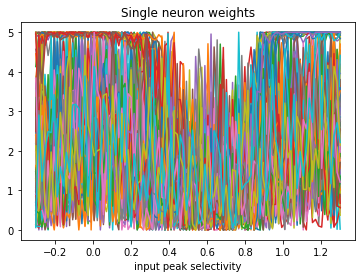

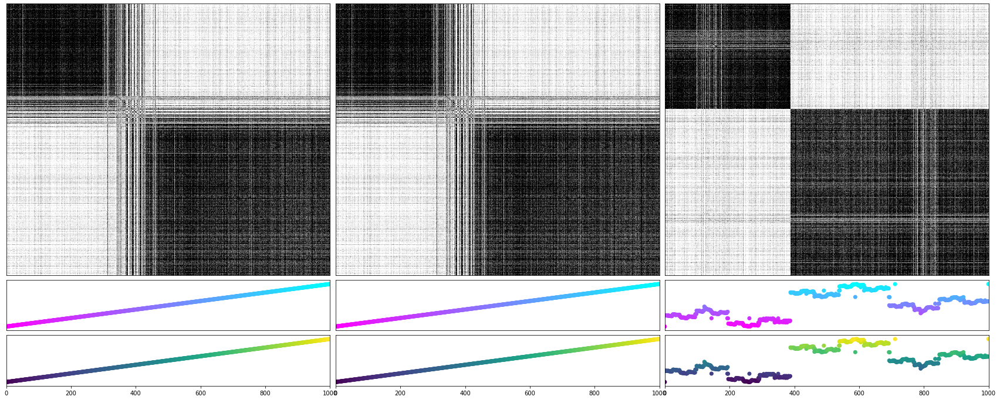

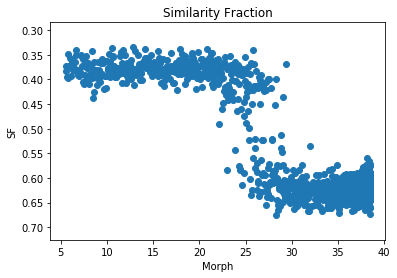

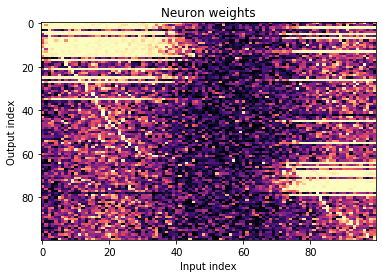

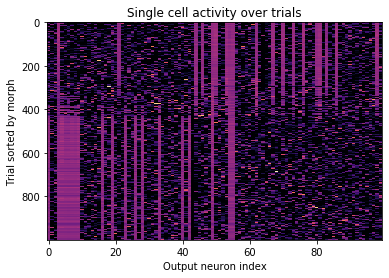

...

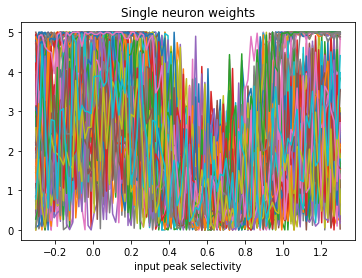

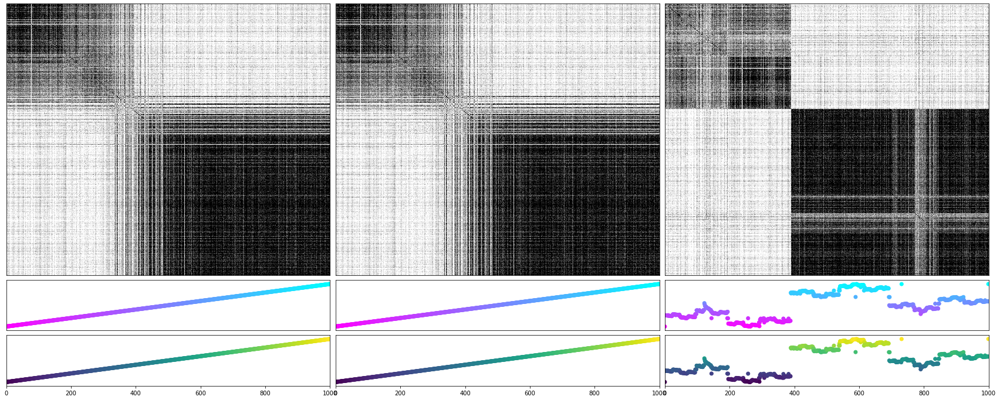

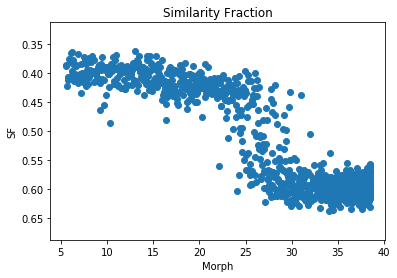

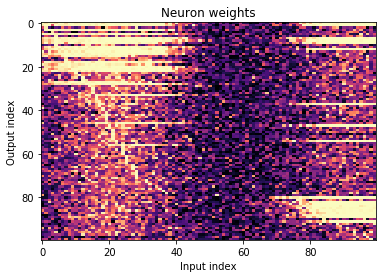

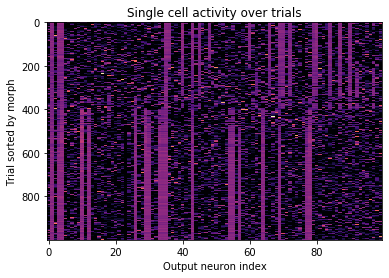

In [10]:
n_models=50
SS_rare,SF_rare = loop_model_instances(rare_spline,d_def,num=n_models,savepath="D:\\Morph_Results\\figures\\KWTA\\rare\\")

0
24.634195837885915
13.625750246122792
7.330481738636814
6.225864036890452
5.76744972332364
5.49948967202529
5.407351120384617
4.185599248472558
18.922787170283367
16.174372415723663
10.153920760049612
6.782751426782781
6.592285418076112
6.268133226131191
4.245314789811023
5.258526060826848
21.42745234459951
13.680835575078138
9.117150916334012
7.90161765933285
5.097734933574859
4.704150643654436
4.3533676804088115
4.444305630672384
22.03063257354693
14.387525792554861
9.256363399404961
5.587177721227081
5.055895700853476
4.2950088951382055
4.355078788157178
3.2687127858598646


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\repos\PlittGiocomo_CA1Morph_2019\SimilarityMatrixAnalysis.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=[30,12])


20.27426799895955
8.974626556422175
5.459739703798189
4.755319024132061
4.5318824278151535
4.313313705964497
4.060694471772514
4.160361764693219


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

20.51432494647928
15.54229706037945
9.406813376847673
7.132410914451702
5.499962480161059
5.083367810703893
4.737110208442658
4.752335136273318


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

18.031663589067374
12.24469222253608
7.94553438541713
6.083469288775403
4.36481953532824
4.030681422709915
3.6498878113276887
3.67168596757933


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

18.10807216125516
14.296422284446964
11.381306083836474
6.742760142294276
6.180436547095013
6.15862339456265
5.887772121172614
5.700303599109179


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

17.049262966958306
13.040387255256599
8.450488143757298
6.877491562443211
6.635229518218076
4.187954057466974
3.998512252765138
3.849152145024032


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

21.69337405673832
13.59058261593118
7.9167214065201446
6.887439715113847
4.81806448904326
4.577985810182644
4.407508005349739
4.173695876069707


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

10


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\repos\PlittGiocomo_CA1Morph_2019\SimilarityMatrixAnalysis.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f = plt.figure(figsize=[30,12])


16.744593494444835
11.15327643050657
8.803568958158877
7.223742620887057
5.247452313788002
4.957239865731418
4.836524463610329
4.403245024882639


C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:34: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
C:\Users\markp\anaconda3\lib\site-packages\ipykernel_launcher.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_op

20
30
40


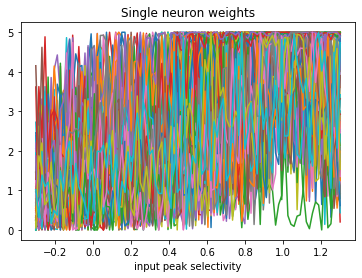

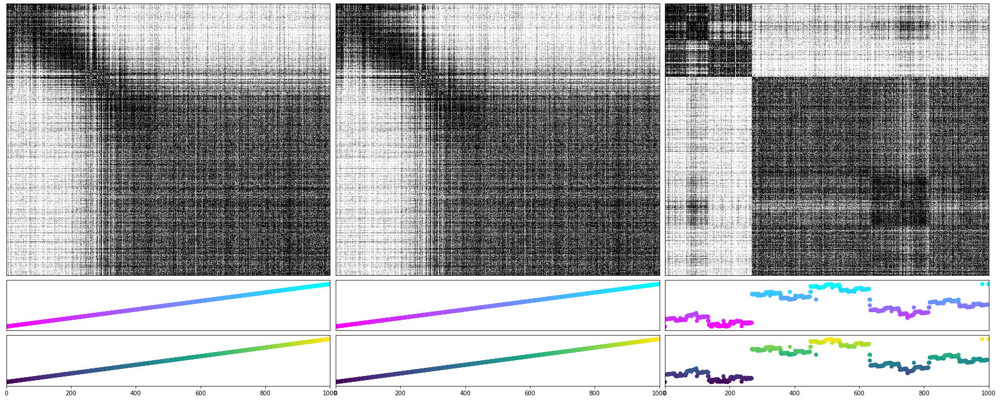

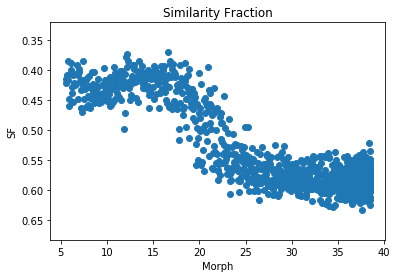

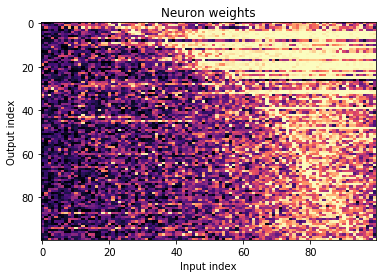

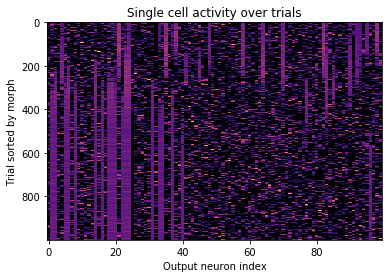

...

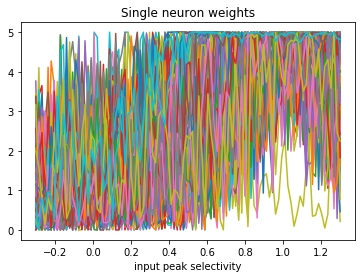

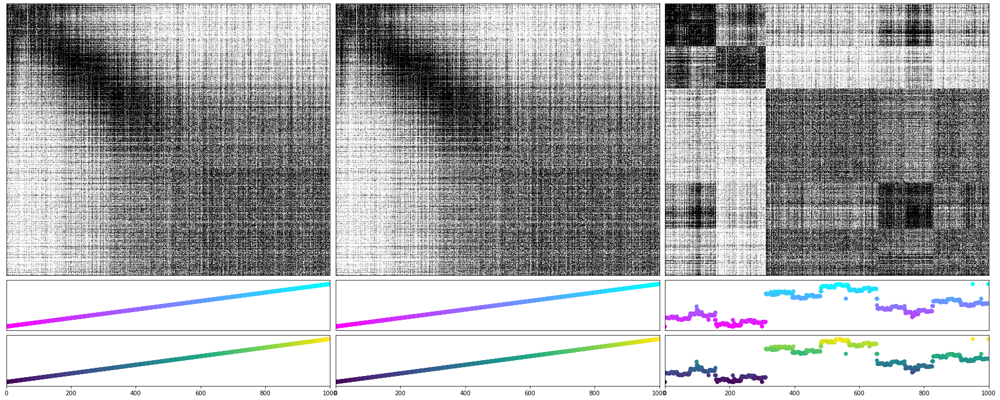

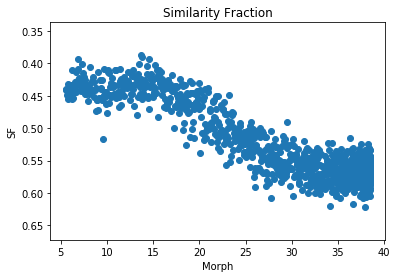

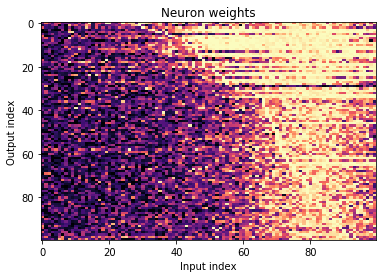

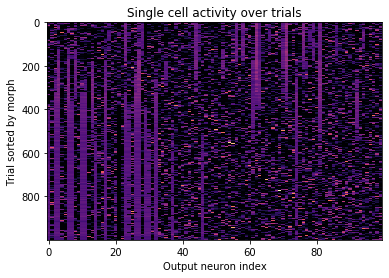

In [11]:
SS_freq,SF_freq = loop_model_instances(freq_spline,d_def,num=n_models,savepath="D:\\Morph_Results\\figures\\KWTA\\freq\\")

In [12]:
print(SS_freq.shape,SF_freq.shape)
SS_freq_norm = np.zeros(SS_freq.shape)
SS_rare_norm = np.zeros(SS_rare.shape)
for it in range(SS_freq.shape[0]):
    freqtmp = np.copy(SS_freq[it,:,:])
    freqtmp[np.diag_indices_from(freqtmp)]=np.nan
    SS_freq_norm[it,:,:] = (freqtmp-np.nanmean(freqtmp))/np.nanstd(freqtmp)
    
    raretmp = np.copy(SS_rare[it,:,:])
    raretmp[np.diag_indices_from(raretmp)]=np.nan
    SS_rare_norm[it,:,:] = (raretmp-np.nanmean(raretmp))/np.nanstd(raretmp)
    
    

(50, 1000, 1000) (50, 1000, 1)


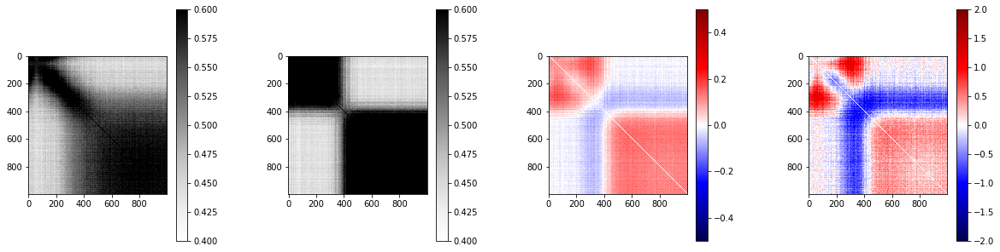

In [13]:
f,ax = plt.subplots(1,4,figsize=[20,5])
f.subplots_adjust(wspace=.5)
im = ax[0].imshow(SS_freq.mean(axis=0),cmap='Greys',vmin=0.4,vmax=.6)
f.colorbar(im,ax=ax[0])
im = ax[1].imshow(SS_rare.mean(axis=0),cmap='Greys',vmin=.4,vmax=.6)
f.colorbar(im,ax=ax[1])
im=ax[2].imshow(SS_rare.mean(axis=0)-SS_freq.mean(axis=0),cmap='seismic',vmin=-.5,vmax=.5)
f.colorbar(im,ax=ax[2])
im=ax[3].imshow(SS_rare_norm.mean(axis=0)-SS_freq_norm.mean(axis=0),cmap='seismic',vmin=-2.,vmax=2.)
f.colorbar(im,ax=ax[3])
# f.savefig("D:\\Morph_Results\\figures\\KWTA\\avgSM.pdf",format="pdf")

In [14]:
morph_theta = np.linspace(-.3,1.3,num=1000)


x = np.linspace(-.3,1.3,num=1000)
xmask = (x>=-.1) & (x<=1.1)
mask0 = (x>=-.1) & (x<=.1)
mask1 = (x>=.9) & (x<=1.1)
HH_rare = 0
HH_freq = 0
wmsm = u.gaussian(ut.wallmorphx(morph_theta[:,np.newaxis,np.newaxis]),.1,x[np.newaxis,:,np.newaxis])
rare_H,rare_H_prior = [],[]
freq_H,freq_H_prior = [],[]
for it in range(SF_rare.shape[0]): 
    print(it)
    sf = SF_rare[it,:]
    yhat = (sf- np.median(sf[mask0]))/(np.median(sf[mask1])-np.median(sf[mask0]))*(1.073-.094) +.094 #(38.051-10.537) + 10.537 #
    yhsm = u.gaussian(yhat.reshape(-1,1,1),.1,x[np.newaxis,np.newaxis,:])# +1E-10
    H = np.sum(wmsm*yhsm,axis=0)
    Z=H.sum(axis=1)
    H/=H.sum(axis=1,keepdims=True)
    
    H_prior =H.sum(axis=0)/(u.gaussian(x[np.newaxis,:],.3,x[:,np.newaxis])/Z[:,np.newaxis]).sum(axis=1)
    H_prior /=H_prior.sum()
    
    rare_H.append(H)
    rare_H_prior.append(H_prior)
    
    HH_rare += H
    
    
    sf = SF_freq[it,:]
    yhat = (sf- np.median(sf[mask0]))/(np.median(sf[mask1])-np.median(sf[mask0]))*(1.073-.094) +.094 #(38.051-10.537) + 10.537 #
    yhsm = u.gaussian(yhat.reshape(-1,1,1),.1,x[np.newaxis,np.newaxis,:])# +1E-10
    H = np.sum(wmsm*yhsm,axis=0)
    Z=H.sum(axis=1)
    H/=H.sum(axis=1,keepdims=True)
    H_prior =H[:,:].sum(axis=0)/(u.gaussian(x[np.newaxis,:],.3,x[:,np.newaxis])/Z[:,np.newaxis]).sum(axis=1)
    H_prior /=H_prior.sum()
    
    freq_H.append(H)
    freq_H_prior.append(H_prior)
    
    HH_freq += H
    
HH_rare /=HH_rare.sum(axis=1,keepdims=True)
HH_freq /=HH_freq.sum(axis=1,keepdims=True)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49


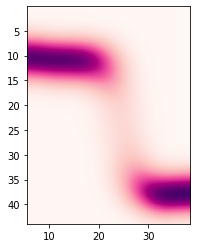

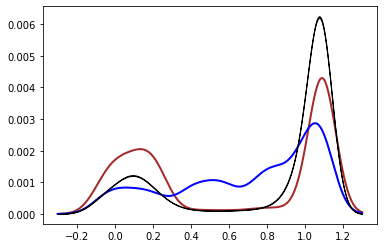

In [15]:
f,ax = plt.subplots()
xmask = (x>=-.1) & (x<=1.1)
ax.imshow(HH_rare[xmask,:].T,cmap='RdPu',extent=[ut.inv_wallmorphx(-.1),ut.inv_wallmorphx(1.1),ut.inv_wallmorphx(1.3),ut.inv_wallmorphx(-.3)])
# f.savefig("D:\\Morph_Results\\figures\\KWTA\\rare_avgpost.pdf",format="pdf")


f,ax = plt.subplots()
rare_H_prior = np.array(rare_H_prior)
mu,sem = rare_H_prior.mean(axis=0),sp.stats.sem(rare_H_prior,axis=0)
ax.fill_between(x,mu+sem,mu-sem,color='black',alpha=1,zorder=1)
ax.plot(x,rare_prior.ravel(),color='brown',linewidth=2,zorder=-1)
ax.plot(x,freq_prior.ravel(),color='blue',linewidth=2,zorder=-1)
# f.savefig("D:\\Morph_Results\\figures\\KWTA\\rare_avgrare.pdf",format="pdf")

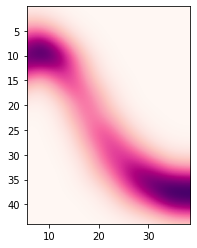

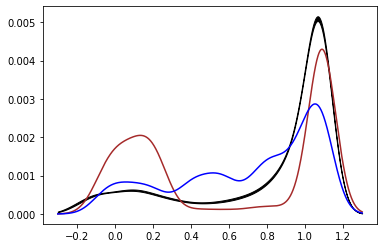

In [16]:
f,ax = plt.subplots()
xmask = (x>=-.1) & (x<=1.1)
ax.imshow(HH_freq[xmask,:].T,cmap='RdPu',extent=[ut.inv_wallmorphx(-.1),ut.inv_wallmorphx(1.1),ut.inv_wallmorphx(1.3),ut.inv_wallmorphx(-.3)])
# f.savefig("D:\\Morph_Results\\figures\\KWTA\\freq_avgpost.pdf",format="pdf")

f,ax = plt.subplots()
freq_H_prior = np.array(freq_H_prior)
mu,sem = freq_H_prior.mean(axis=0),sp.stats.sem(freq_H_prior,axis=0)
ax.fill_between(x,mu+sem,mu-sem,color='black',alpha=1)
ax.plot(x,rare_prior.ravel(),color='brown')
ax.plot(x,freq_prior.ravel(),color='blue')
# f.savefig("D:\\Morph_Results\\figures\\KWTA\\freq_avgrare.pdf",format="pdf")

In [20]:

def calc_kldivs(H_list):
    kldivs=[]
    for H in H_list:
        rare_kl,freq_kl = [],[]
        for row in range(H.shape[1]):
            if (x[row]>=.1) and (x[row]<=1.1):
                rare_kl.append(sp.stats.entropy(rare_post[row,:],H[row,:],base=2))
                freq_kl.append(sp.stats.entropy(freq_post[row,:],H[row,:],base=2))
        kldivs.append(np.array(rare_kl).mean()-np.array(freq_kl).mean())
    return kldivs
rare_kldivs,freq_kldivs = calc_kldivs(rare_H), calc_kldivs(freq_H)

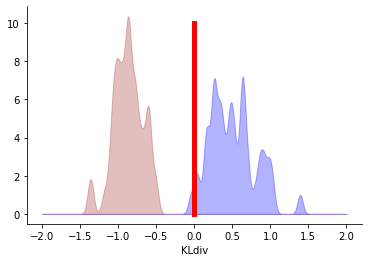

In [27]:
rare_kldivs_sm = u.gaussian(np.array(rare_kldivs)[:,np.newaxis],.05,np.linspace(-2.,2.,num=1000)[np.newaxis,:]).sum(axis=0)
freq_kldivs_sm = u.gaussian(np.array(freq_kldivs)[:,np.newaxis],.05,np.linspace(-2.,2,num=1000)[np.newaxis,:]).sum(axis=0)
f,ax = plt.subplots()
ax.fill_between(np.linspace(-2,2,num=1000),rare_kldivs_sm,color='brown',alpha=.3)
ax.fill_between(np.linspace(-2,2,num=1000),freq_kldivs_sm,color='blue',alpha=.3)
ax.plot([0,0],[0,10],color='red',linewidth=5)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

ax.set_xlabel('KLdiv')
f.savefig("D:\\Morph_Results\\figures\\KWTA\\kldiv_hist.pdf",format="pdf")


-0.3553724620928098 0.12542939571101858


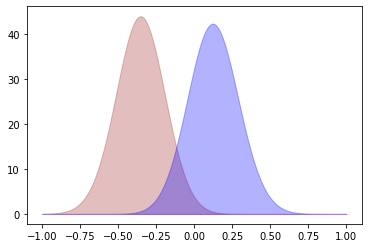

In [26]:
rare_prior_kldivs=[]
freq_prior_kldivs=[]
for it in range(rare_H_prior.shape[0]):
    rare_prior_kldivs.append(sp.stats.entropy(rare_prior.ravel(),rare_H_prior[it,:].ravel())-sp.stats.entropy(freq_prior.ravel(),rare_H_prior[it,:].ravel()) )
    freq_prior_kldivs.append(sp.stats.entropy(rare_prior.ravel(),freq_H_prior[it,:].ravel())-sp.stats.entropy(freq_prior.ravel(),freq_H_prior[it,:].ravel()) )

print(np.array(rare_prior_kldivs).mean(),np.array(freq_prior_kldivs).mean())
rare_prior_kldivs_sm = u.gaussian(np.array(rare_prior_kldivs)[:,np.newaxis],.20,np.linspace(-1,1,num=1000)[np.newaxis,:]).sum(axis=0)
freq_prior_kldivs_sm = u.gaussian(np.array(freq_prior_kldivs)[:,np.newaxis],.20,np.linspace(-1,1,num=1000)[np.newaxis,:]).sum(axis=0)
f,ax = plt.subplots()
ax.fill_between(np.linspace(-1,1,num=1000),rare_prior_kldivs_sm,color='brown',alpha=.3)
ax.fill_between(np.linspace(-1,1,num=1000),freq_prior_kldivs_sm,color='blue',alpha=.3)

NameError: name 'kldivs' is not defined

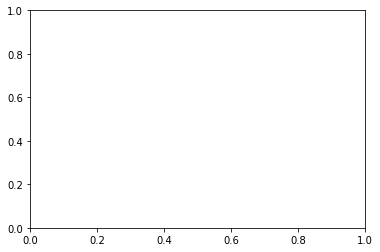

In [21]:
f,ax= plt.subplots()
ax.hist(kldivs)

In [32]:
print(ut.inv_wallmorphx(.4)-ut.inv_wallmorphx(.1))

8.226206354721889


In [33]:
.3/1.2

0.25